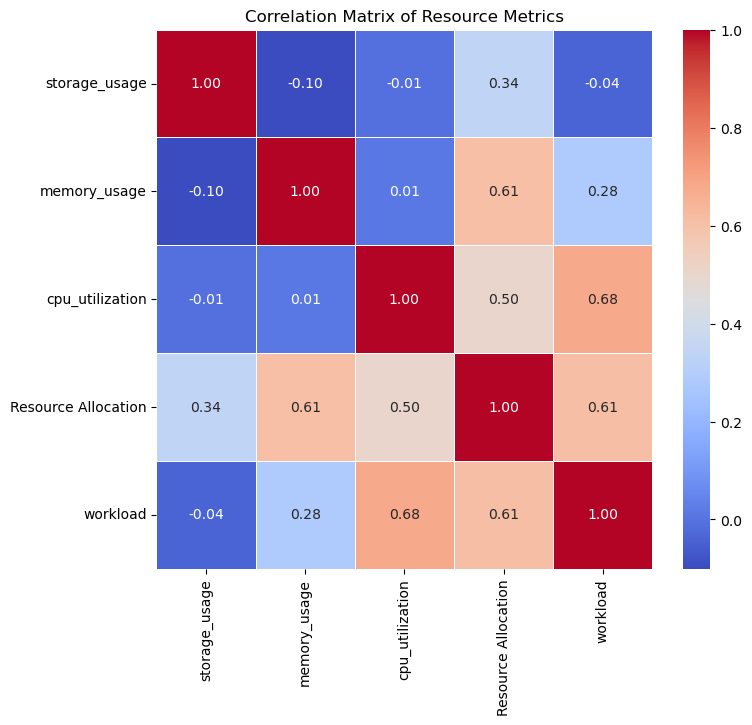

In [1]:
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import warnings
import plotly.express as px
warnings.filterwarnings('ignore')

# Sample DataFrame creation for demonstration
df = pd.read_csv('../Data/Processed_Resource_utilization.csv')  

correlation_matrix = df[ ['storage_usage','memory_usage','cpu_utilization','Resource Allocation','workload']].corr()

plt.figure(figsize=(8, 7))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=.5)
plt.title('Correlation Matrix of Resource Metrics')
plt.show()

In [2]:
metrics = ['cpu_utilization', 'memory_usage', 'storage_usage', 'workload']
for metric in metrics:
    fig = px.scatter(
        df, x=metric, y='Resource Allocation', trendline="ols",
        labels={'Resource Allocation': 'Resource Allocation', metric: metric},
        title=f"Resource Allocation vs {metric}", width=600, height=400
    )
    fig.show()

In [3]:
fig = px.histogram(
    df, x="storage_usage", nbins=30, color_discrete_sequence=['skyblue'],
    title="Distribution of Storage Usage", width=600, height=400
)
fig.add_vline(x=df["storage_usage"].max(), line_color="green",
              annotation_text=f"Max: {df['storage_usage'].max()}", annotation_position="top right")
fig.show()

print("Max Storage Usage:", df["storage_usage"].max())
print("95th percentile:", df["storage_usage"].quantile(0.95))

Max Storage Usage: 100.0
95th percentile: 100.0


In [4]:
fig = px.histogram(
    df, x="memory_usage", nbins=30, color_discrete_sequence=['skyblue'],
    title="Distribution of Memory Usage", width=600, height=400
)
fig.add_vline(x=85, line_color="red", annotation_text="85 (cap)", annotation_position="top left")
fig.add_vline(x=df["memory_usage"].max(), line_color="green",
              annotation_text=f"Max: {df['memory_usage'].max()}", annotation_position="top right")
fig.show()

print("Max memory observed:", df["memory_usage"].max())
print("95th percentile:", df["memory_usage"].quantile(0.95))
print("Values above 85:", (df["memory_usage"] > 85).sum())


Max memory observed: 94.97212280704171
95th percentile: 82.15649273421904
Values above 85: 894


In [5]:
fig = px.histogram(
    df, x="cpu_utilization", nbins=30, color_discrete_sequence=['skyblue'],
    title="Distribution of CPU Utilization", width=600, height=400
)

fig.add_vline(x=df["cpu_utilization"].max(), line_color="green",
              annotation_text=f"Max: {df['cpu_utilization'].max()}", annotation_position="top right")
fig.show()



In [6]:
fig = px.histogram(df, x='workload', nbins=50, color_discrete_sequence=['skyblue'],
                   title="Workload Distribution", width=600, height=400)
fig.show()

print(df['workload'].describe())

count    26305.000000
mean        90.774507
std         11.618224
min         38.108351
25%         83.511317
50%         96.614610
75%        100.000000
max        100.000000
Name: workload, dtype: float64


In [7]:
fig = px.line(df, x='timestamp', y='Resource Allocation', title='Resource Allocation Over Time', width=800, height=400)
fig.show()


In [8]:
fig = px.line(df, x='timestamp', y='cpu_utilization', title='CPU Utilization Over Time', width=800, height=400)
fig.show()


In [9]:
fig = px.line(df, x='timestamp', y='memory_usage', title='Memory Usage Over Time', width=800, height=400)
fig.show()


In [10]:
fig = px.line(df, x='timestamp', y='storage_usage', title='Storage Usage Over Time', width=800, height=400)
fig.show()